In [ ]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

In [1]:
import os
import cv2
import numpy as np
from skimage.metrics import structural_similarity as ssim

# المسارات
main_folder = "/kaggle/input/fusion/final data/CT"
output_folder = "/kaggle/working/ProcessedCT"
os.makedirs(output_folder, exist_ok=True)

# دوال التقييم
def calculate_mse(imageA, imageB):
    return np.mean((imageA - imageB) ** 2)

def calculate_psnr(mse, max_pixel=255.0):
    return 20 * np.log10(max_pixel / np.sqrt(mse)) if mse != 0 else float('inf')

total_images = 0
for folder_name in sorted(os.listdir(main_folder)):
    folder_path = os.path.join(main_folder, folder_name)
    
    if os.path.isdir(folder_path):
        output_subfolder = os.path.join(output_folder, folder_name)
        os.makedirs(output_subfolder, exist_ok=True)

        for image_name in sorted(os.listdir(folder_path)):
            image_path = os.path.join(folder_path, image_name)
            
            if image_path.lower().endswith(".jpg"):
                try:
                    # 1. تحميل الصورة
                    image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)
                    if image is None:
                        print(f"خطأ: لم يتم تحميل الصورة {image_path}")
                        continue

                    # 2. إعادة تحجيم الصورة إلى 256x256
                    original_image = cv2.resize(image, (256, 256))

                    # 3. تطبيع الصورة (Normalization)
                    image_normalized = cv2.normalize(original_image, None, 0, 255, cv2.NORM_MINMAX)
                    
                    # 4. تحسين إزالة الضوضاء
                    image_denoised = cv2.fastNlMeansDenoising(image_normalized, None, 30, 7, 21)

                    # 5. Gamma Correction ديناميكي
                    mean_intensity = np.mean(image_denoised)
                    gamma = 1.5 if mean_intensity < 100 else 2.0
                    gamma_corrected = np.array(255 * (image_denoised / 255) ** gamma, dtype='uint8')

                    # 6. Histogram Equalization
                    enhanced_image = cv2.equalizeHist(gamma_corrected)

                    # 7. Image Registration باستخدام ORB
                    orb = cv2.ORB_create()
                    keypoints, descriptors = orb.detectAndCompute(enhanced_image, None)
                    # registered_image = cv2.drawKeypoints(enhanced_image, keypoints, None, color=(0, 255, 0))
                    registered_image = enhanced_image.copy()

                    # 8. Edge Detection
                    edges = cv2.Canny(enhanced_image, 70, 150)

                    # 9. حساب معايير التقييم
                    mse_final = calculate_mse(original_image, enhanced_image)
                    psnr_final = calculate_psnr(mse_final)
                    ssim_final = ssim(original_image, enhanced_image)

                    print(f"{image_name} - Final Processed - MSE: {mse_final}, PSNR: {psnr_final}, SSIM: {ssim_final}")

                    # حفظ الصور
                    # output_processed_path = os.path.join(output_subfolder, f"{image_name}_processed.jpg")
                    # cv2.imwrite(output_processed_path, enhanced_image)

                    output_registered_path = os.path.join(output_subfolder, f"{image_name}_registered.jpg")
                    cv2.imwrite(output_registered_path, registered_image)

                    # output_edges_path = os.path.join(output_subfolder, f"{image_name}_edges.jpg")
                    # cv2.imwrite(output_edges_path, edges)

                    total_images += 1

                except Exception as e:
                    print(f"خطأ أثناء معالجة الصورة {image_name}: {e}")
                    continue

print(f"تمت معالجة عدد الصور: {total_images}")


ct.jpg - Final Processed - MSE: 9.520217895507812, PSNR: 38.34433472385356, SSIM: 0.9002752193275846
ct.jpg - Final Processed - MSE: 9.611953735351562, PSNR: 38.302686890949616, SSIM: 0.964227300568369
ct.jpg - Final Processed - MSE: 41.02268981933594, PSNR: 32.000562276196675, SSIM: 0.765462598737356
ct.jpg - Final Processed - MSE: 34.405731201171875, PSNR: 32.764495688276384, SSIM: 0.8102960154751043
ct.jpg - Final Processed - MSE: 34.640533447265625, PSNR: 32.73495789548583, SSIM: 0.8026480967685921
ct.jpg - Final Processed - MSE: 34.78453063964844, PSNR: 32.716942132284586, SSIM: 0.845134793419873
ct.jpg - Final Processed - MSE: 32.40843200683594, PSNR: 33.02422341475688, SSIM: 0.8223763053787889
ct.jpg - Final Processed - MSE: 34.64434814453125, PSNR: 32.73447966648804, SSIM: 0.8385595329055334
ct.jpg - Final Processed - MSE: 28.197006225585938, PSNR: 33.62877360659469, SSIM: 0.8554417032503139
ct.jpg - Final Processed - MSE: 36.61912536621094, PSNR: 32.4937239373578, SSIM: 0.7838

In [2]:
import os
import cv2
import numpy as np
from skimage.metrics import structural_similarity as ssim

# المسارات
main_folder = "/kaggle/input/fusion/final data/MRI"
output_folder = "/kaggle/working/ProcessedMRI"
os.makedirs(output_folder, exist_ok=True)

# دوال التقييم
def calculate_mse(imageA, imageB):
    return np.mean((imageA - imageB) ** 2)

def calculate_psnr(mse, max_pixel=255.0):
    return 20 * np.log10(max_pixel / np.sqrt(mse)) if mse != 0 else float('inf')

# تحسين Bias Field Correction
def bias_field_correction(image):
    rows, cols = image.shape
    x = np.linspace(-1, 1, cols)
    y = np.linspace(-1, 1, rows)
    xv, yv = np.meshgrid(x, y)
    bias_field = 1 + 0.2 * (xv**2 + yv**2)
    blurred_bias = cv2.GaussianBlur(bias_field, (31, 31), 0)
    corrected_image = image / blurred_bias
    corrected_image = np.clip(corrected_image, 0, 255).astype(np.uint8)
    return corrected_image

# Skull Stripping
def skull_stripping(image):
    _, binary_mask = cv2.threshold(image, 30, 255, cv2.THRESH_BINARY)
    kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (7, 7))
    binary_mask = cv2.morphologyEx(binary_mask, cv2.MORPH_CLOSE, kernel)
    skull_stripped = cv2.bitwise_and(image, binary_mask)
    return skull_stripped

# Adaptive Min-Max Normalization
def adaptive_min_max_normalization(image):
    p2, p98 = np.percentile(image, (2, 98))
    normalized = cv2.normalize(image, None, p2, p98, cv2.NORM_MINMAX)
    return normalized.astype(np.uint8)

# Noise Reduction (Non-Local Means Denoising)
def noise_reduction(image):
    return cv2.fastNlMeansDenoising(image, None, h=10, templateWindowSize=7, searchWindowSize=21)

# Contrast Enhancement (Gamma Correction)
def gamma_correction(image, gamma=1.02):  # Gamma أقل
    corrected = np.array(255 * (image / 255) ** gamma, dtype='uint8')
    return corrected

# Adaptive Histogram Equalization
def adaptive_histogram_equalization(image):
    clahe = cv2.createCLAHE(clipLimit=1.2, tileGridSize=(8, 8))
    return clahe.apply(image)

# Unsharp Masking
def unsharp_mask(image, strength=1.2):
    blurred = cv2.GaussianBlur(image, (5, 5), 0)
    sharpened = cv2.addWeighted(image, 1 + strength, blurred, -strength, 0)
    return sharpened

# Edge Detection (Canny)
def edge_detection(image):
    return cv2.Canny(image, 40, 100)

# Multi-level Weighted Blending
def multi_level_blending(original, processed, alpha=0.7):
    return cv2.addWeighted(original, alpha, processed, 1 - alpha, 0)

total_images = 0
for folder_name in sorted(os.listdir(main_folder)):
    folder_path = os.path.join(main_folder, folder_name)
    
    if os.path.isdir(folder_path):
        output_subfolder = os.path.join(output_folder, folder_name)
        os.makedirs(output_subfolder, exist_ok=True)

        for image_name in sorted(os.listdir(folder_path)):
            image_path = os.path.join(folder_path, image_name)
            
            if image_path.lower().endswith(".jpg"):
                try:
                    # 1. تحميل الصورة
                    image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)
                    if image is None:
                        print(f"خطأ: لم يتم تحميل الصورة {image_path}")
                        continue

                    # 2. إعادة تحجيم الصورة إلى 256x256
                    original_image = cv2.resize(image, (256, 256))

                    # 3. Bias Field Correction
                    image_bias_corrected = bias_field_correction(original_image)

                    # 4. Skull Stripping
                    image_skull_stripped = skull_stripping(image_bias_corrected)

                    # 5. Adaptive Min-Max Normalization
                    image_normalized = adaptive_min_max_normalization(image_skull_stripped)

                    # 6. Noise Reduction (Non-Local Means)
                    image_denoised = noise_reduction(image_normalized)

                    # 7. Contrast Enhancement
                    image_gamma_corrected = gamma_correction(image_denoised, gamma=1.02)
                    image_contrast_enhanced = adaptive_histogram_equalization(image_gamma_corrected)

                    # 8. Detail Enhancement (Unsharp Masking)
                    image_sharpened = unsharp_mask(image_contrast_enhanced)

                    # 9. Multi-level Weighted Blending
                    blended_image = multi_level_blending(original_image, image_sharpened, alpha=0.7)
                     # . Image Registration باستخدام ORB
                    orb = cv2.ORB_create()
                    keypoints, descriptors = orb.detectAndCompute(blended_image, None)
                    registered_image = blended_image.copy()


                    # 10. Edge Detection (Canny)
                    edges = edge_detection(blended_image)

                    # 11. حساب معايير التقييم
                    mse_final = calculate_mse(original_image, blended_image)
                    psnr_final = calculate_psnr(mse_final)
                    ssim_final = ssim(original_image, blended_image)

                    print(f"{image_name} - Blended - MSE: {mse_final:.2f}, PSNR: {psnr_final:.2f}, SSIM: {ssim_final:.2f}")

                    # حفظ الصور
                    # output_processed_path = os.path.join(output_subfolder, f"{image_name}_processed.jpg")
                    # cv2.imwrite(output_processed_path, blended_image)

                    output_registered_path = os.path.join(output_subfolder, f"{image_name}_registered.jpg")
                    cv2.imwrite(output_registered_path, registered_image)


                    # output_edges_path = os.path.join(output_subfolder, f"{image_name}_edges.jpg")
                    # cv2.imwrite(output_edges_path, edges)

                    total_images += 1

                except Exception as e:
                    print(f"خطأ أثناء معالجة الصورة {image_name}: {e}")
                    continue

print(f"تمت معالجة عدد الصور: {total_images}")


mri.jpg - Blended - MSE: 16.90, PSNR: 35.85, SSIM: 0.98
mri.jpg - Blended - MSE: 12.50, PSNR: 37.16, SSIM: 0.98
mri.jpg - Blended - MSE: 19.89, PSNR: 35.14, SSIM: 0.97
mri.jpg - Blended - MSE: 18.95, PSNR: 35.35, SSIM: 0.92
mri.jpg - Blended - MSE: 8.86, PSNR: 38.66, SSIM: 0.96
mri.jpg - Blended - MSE: 15.58, PSNR: 36.20, SSIM: 0.96
mri.jpg - Blended - MSE: 14.87, PSNR: 36.41, SSIM: 0.99
mri.jpg - Blended - MSE: 16.62, PSNR: 35.92, SSIM: 0.97
mri.jpg - Blended - MSE: 11.52, PSNR: 37.52, SSIM: 0.96
mri.jpg - Blended - MSE: 14.60, PSNR: 36.49, SSIM: 0.97
mri.jpg - Blended - MSE: 12.25, PSNR: 37.25, SSIM: 0.95
mri.jpg - Blended - MSE: 18.52, PSNR: 35.46, SSIM: 0.91
mri.jpg - Blended - MSE: 11.99, PSNR: 37.34, SSIM: 0.96
mri_2.jpg - Blended - MSE: 8.29, PSNR: 38.95, SSIM: 0.94
mri-2.jpg - Blended - MSE: 14.01, PSNR: 36.67, SSIM: 0.95
mri-3.jpg - Blended - MSE: 8.09, PSNR: 39.05, SSIM: 0.95
mri-4.jpg - Blended - MSE: 6.75, PSNR: 39.84, SSIM: 0.90
mri-5.jpg - Blended - MSE: 27.71, PSNR: 33.7

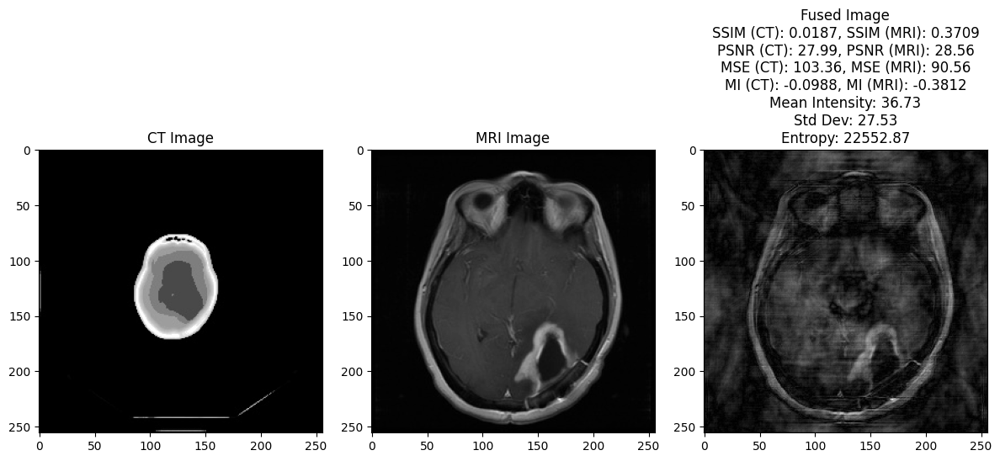

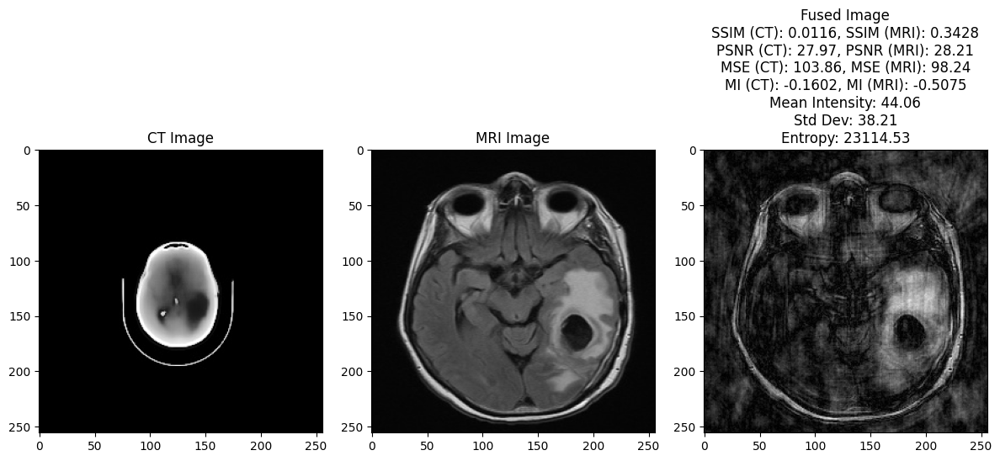

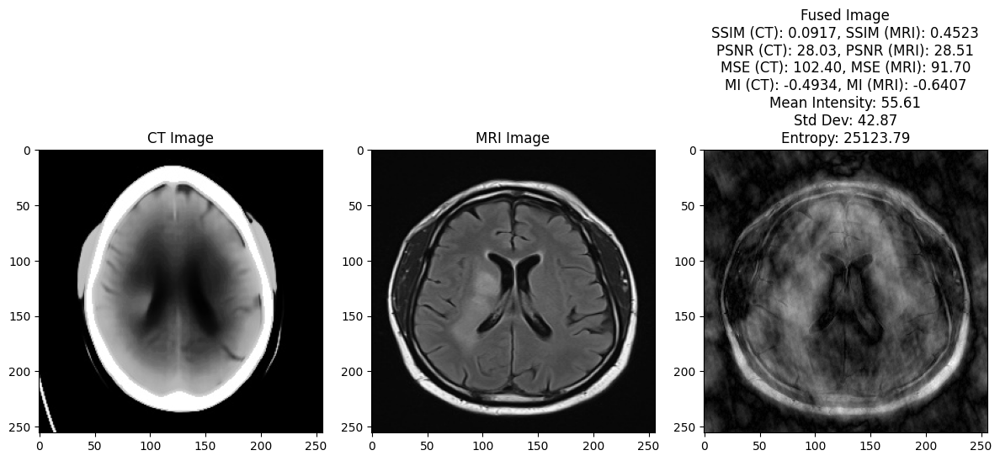

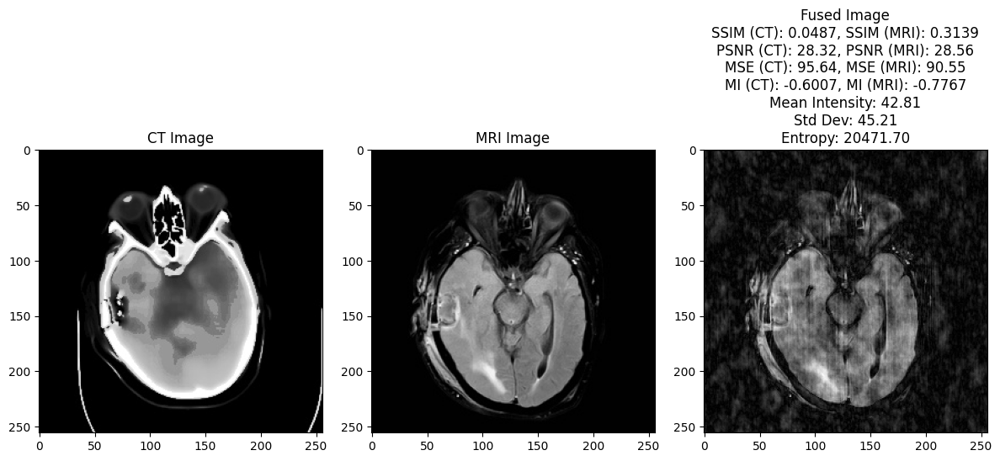

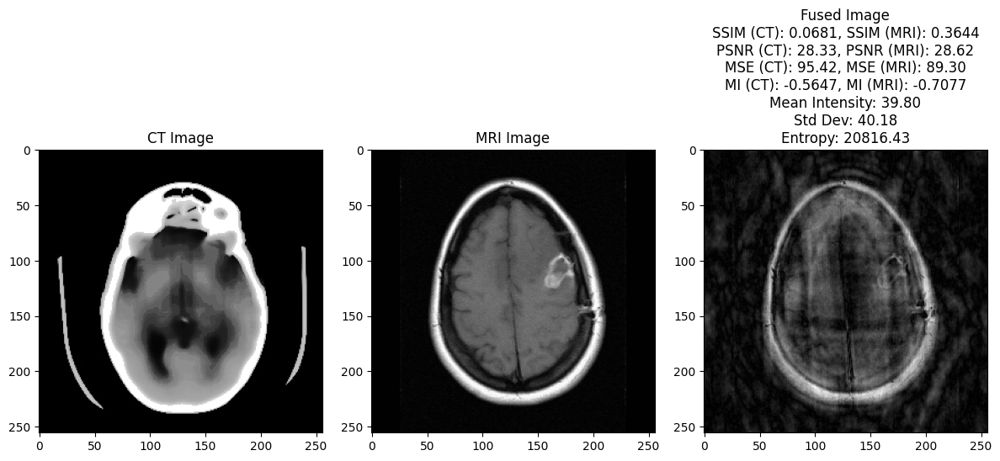

...

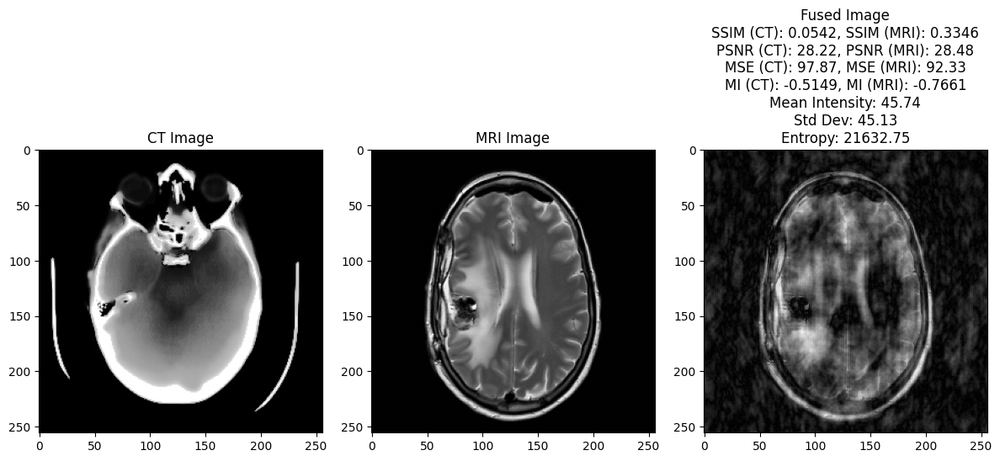

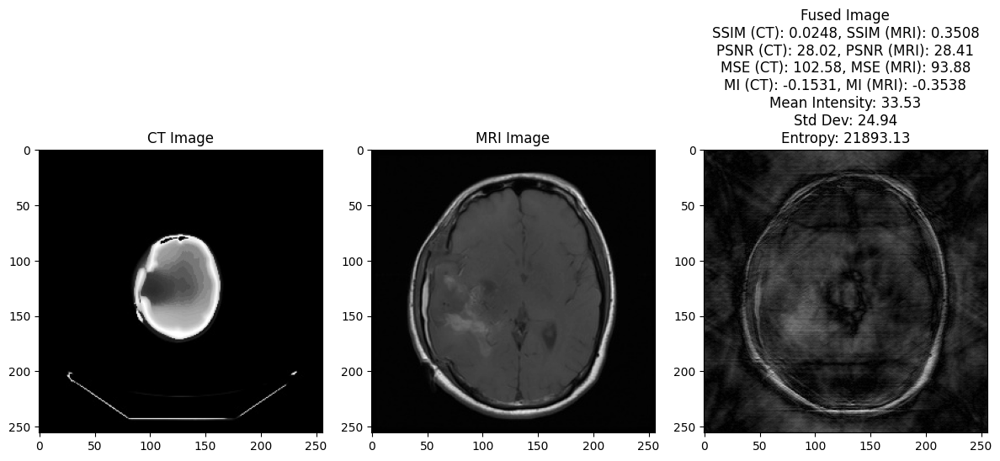

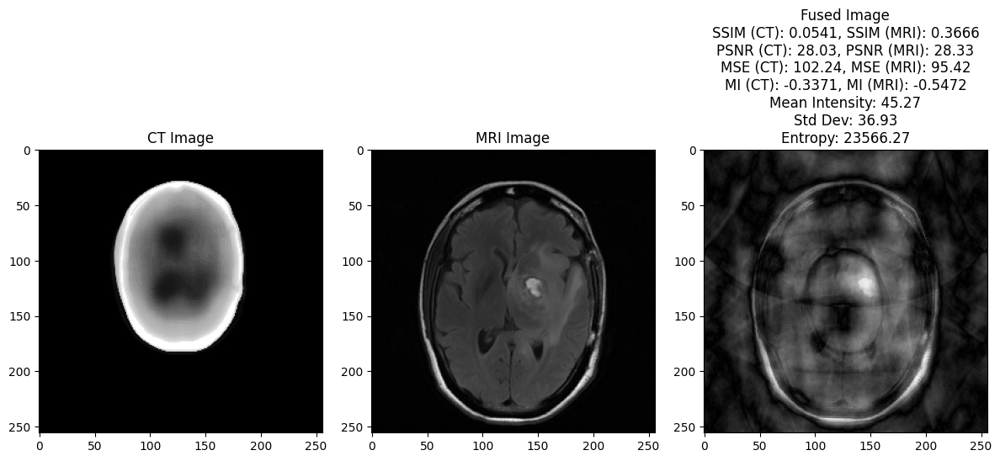

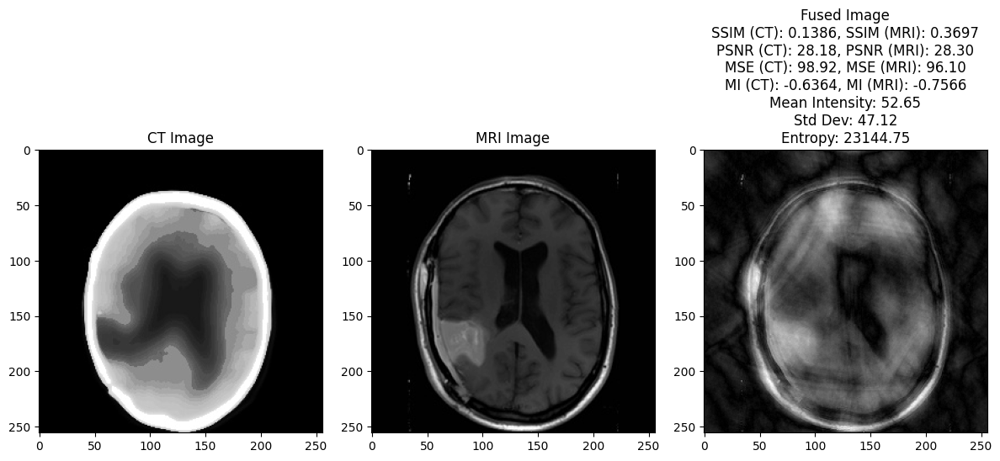

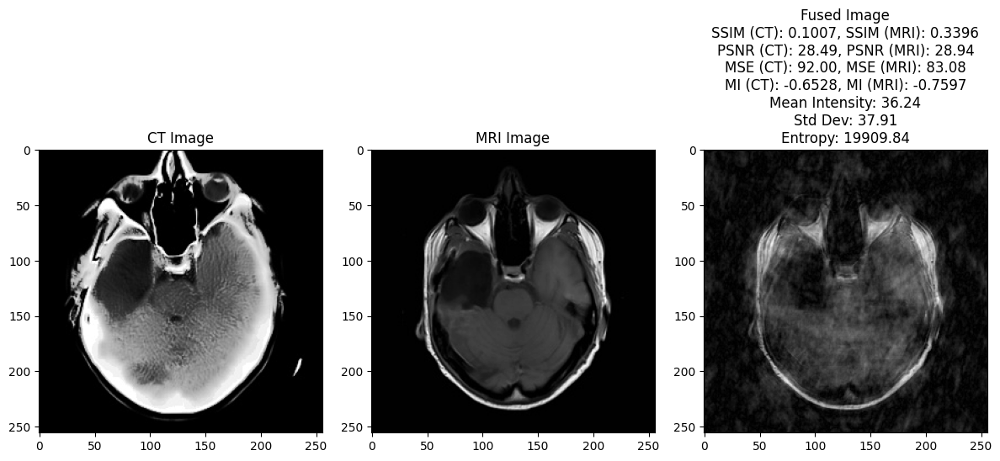

تم دمج الصور وحفظها في فولدر '/kaggle/working/fused'.


In [10]:
# import os
# import cv2
# import numpy as np
# from matplotlib import pyplot as plt
# from skimage.metrics import structural_similarity as ssim
# from sklearn.metrics import mean_squared_error
# from scipy.stats import entropy  # لحساب MI

# # المسارات الرئيسية
# ct_folder = "/kaggle/working/ProcessedCT"
# mri_folder = "/kaggle/working/ProcessedMRI"
# output_folder = "/kaggle/working/fused"

# # التأكد من وجود فولدر الناتج
# os.makedirs(output_folder, exist_ok=True)

# # حساب PSNR
# def calculate_psnr(img1, img2):
#     mse = np.mean((img1 - img2) ** 2)
#     if mse == 0:
#         return float("inf")
#     max_pixel = 255.0
#     return 20 * np.log10(max_pixel / np.sqrt(mse))

# # حساب Mutual Information (MI)
# def calculate_mutual_information(image1, image2):
#     joint_histogram, _, _ = np.histogram2d(image1.ravel(), image2.ravel(), bins=256)
#     joint_prob = joint_histogram / joint_histogram.sum()
#     mi = entropy(joint_prob.ravel()) - entropy(joint_prob.sum(axis=0)) - entropy(joint_prob.sum(axis=1))
#     return mi

# # دمج الصور
# for ct_subfolder, mri_subfolder in zip(ct_subfolders, mri_subfolders):
#     ct_path = os.path.join(ct_folder, ct_subfolder)
#     mri_path = os.path.join(mri_folder, mri_subfolder)

#     # قراءة الصور داخل الفولدرات الفرعية
#     ct_image_name = os.listdir(ct_path)[0]
#     mri_image_name = os.listdir(mri_path)[0]

#     ct_image = cv2.imread(os.path.join(ct_path, ct_image_name), cv2.IMREAD_GRAYSCALE)
#     mri_image = cv2.imread(os.path.join(mri_path, mri_image_name), cv2.IMREAD_GRAYSCALE)

#     # توحيد الأبعاد باستخدام حجم الصورة الأصغر
#     target_size = (min(ct_image.shape[1], mri_image.shape[1]), min(ct_image.shape[0], mri_image.shape[0]))
#     ct_image = cv2.resize(ct_image, target_size, interpolation=cv2.INTER_AREA)
#     mri_image = cv2.resize(mri_image, target_size, interpolation=cv2.INTER_AREA)

#     # Fourier Transform لكل صورة
#     ct_fft = np.fft.fft2(ct_image)
#     mri_fft = np.fft.fft2(mri_image)

#     ct_magnitude, ct_phase = np.abs(ct_fft), np.angle(ct_fft)
#     mri_magnitude, mri_phase = np.abs(mri_fft), np.angle(mri_fft)

#     # دمج الترددات (اختيار Magnitude من CT وPhase من MRI)
#     fused_fft = ct_magnitude * np.exp(1j * mri_phase)

#     # Inverse Fourier Transform
#     fused_image = np.fft.ifft2(fused_fft)
#     fused_image = np.abs(fused_image)
#     fused_image = (fused_image / np.max(fused_image) * 255).astype(np.uint8)

#     # حساب القيم الإحصائية للصورة المدموجة
#     mean_intensity = np.mean(fused_image)
#     std_dev_intensity = np.std(fused_image)
#     entropy_value = -np.sum(
#         (fused_image / 255) * np.log2(fused_image / 255 + 1e-9)
#     )  # لحساب التعقيد

#     # حساب SSIM و PSNR و MSE و MI
#     ssim_ct = ssim(ct_image, fused_image, data_range=fused_image.max() - fused_image.min())
#     ssim_mri = ssim(mri_image, fused_image, data_range=fused_image.max() - fused_image.min())
#     psnr_ct = calculate_psnr(ct_image, fused_image)
#     psnr_mri = calculate_psnr(mri_image, fused_image)
#     mse_ct = mean_squared_error(ct_image.flatten(), fused_image.flatten())
#     mse_mri = mean_squared_error(mri_image.flatten(), fused_image.flatten())
#     mi_ct = calculate_mutual_information(ct_image, fused_image)
#     mi_mri = calculate_mutual_information(mri_image, fused_image)

#     # حفظ الصورة الناتجة
#     output_path = os.path.join(output_folder, f"{ct_subfolder}_fused.png")
#     cv2.imwrite(output_path, fused_image)

#     # عرض الصور والنتائج
#     plt.figure(figsize=(12, 6))
#     plt.subplot(1, 3, 1), plt.imshow(ct_image, cmap='gray'), plt.title("CT Image")
#     plt.subplot(1, 3, 2), plt.imshow(mri_image, cmap='gray'), plt.title("MRI Image")
#     plt.subplot(1, 3, 3), plt.imshow(fused_image, cmap='gray'), plt.title(
#         f"Fused Image\nSSIM (CT): {ssim_ct:.4f}, SSIM (MRI): {ssim_mri:.4f}\n"
#         f"PSNR (CT): {psnr_ct:.2f}, PSNR (MRI): {psnr_mri:.2f}\n"
#         f"MSE (CT): {mse_ct:.2f}, MSE (MRI): {mse_mri:.2f}\n"
#         f"MI (CT): {mi_ct:.4f}, MI (MRI): {mi_mri:.4f}\n"
#         f"Mean Intensity: {mean_intensity:.2f}\n"
#         f"Std Dev: {std_dev_intensity:.2f}\n"
#         f"Entropy: {entropy_value:.2f}"
#     )
#     plt.tight_layout()
#     plt.show()

# print(f"تم دمج الصور وحفظها في فولدر '{output_folder}'.")

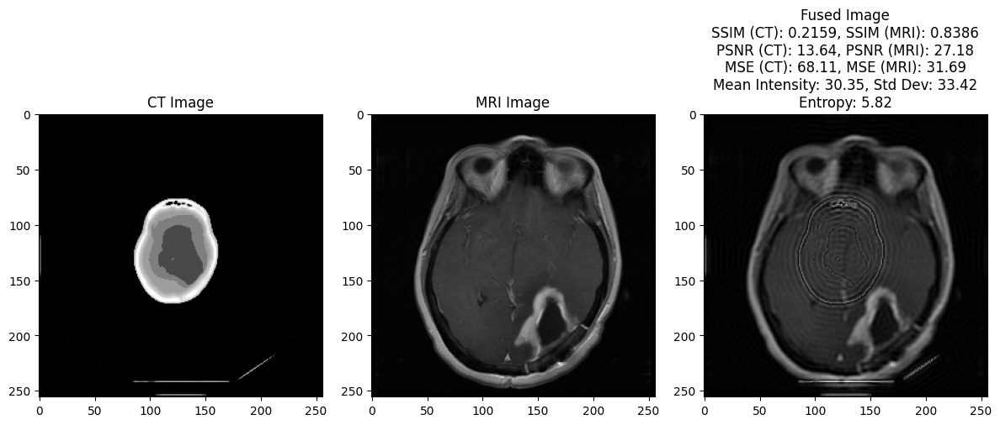

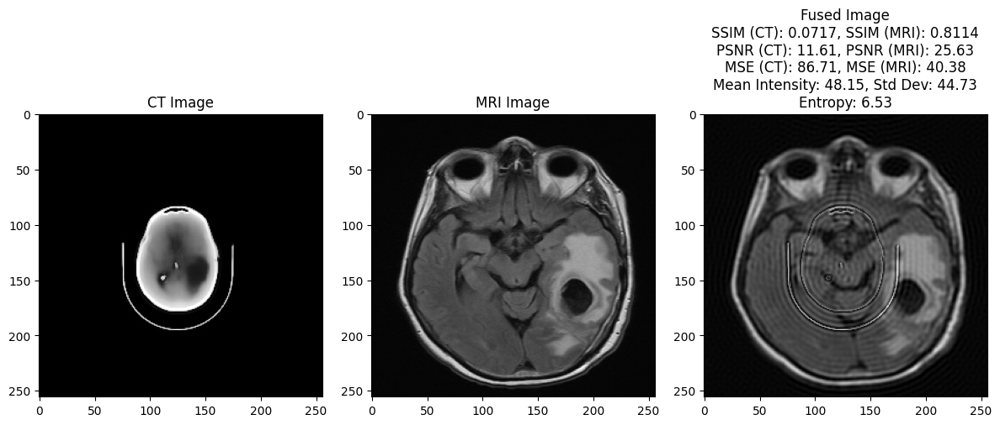

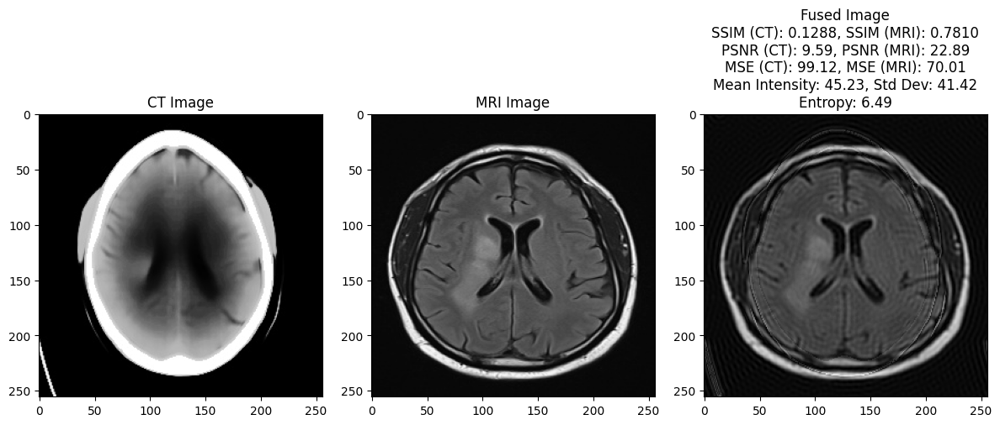

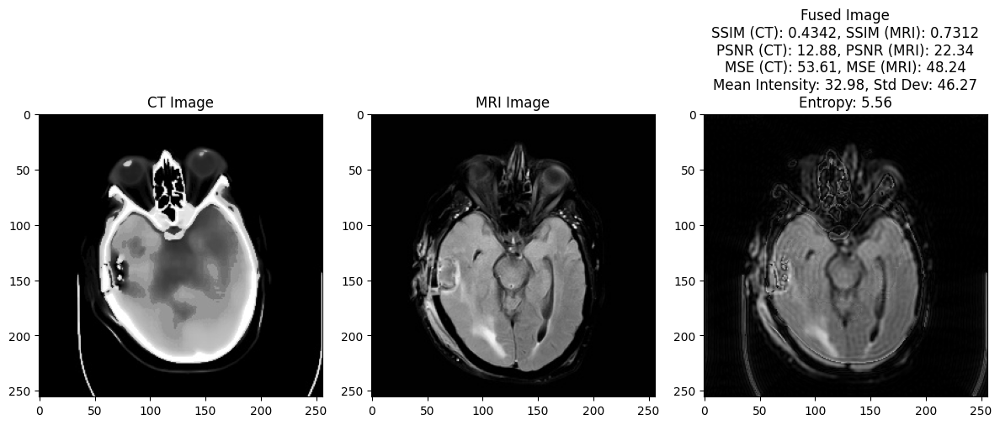

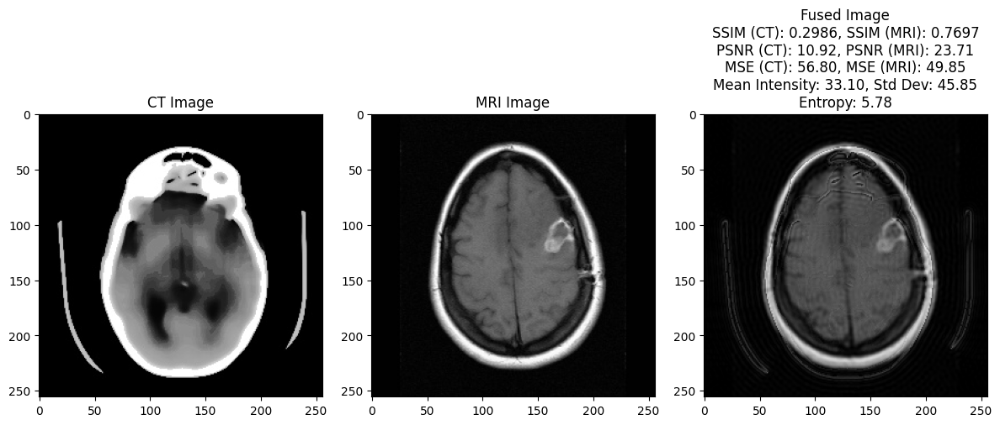

...

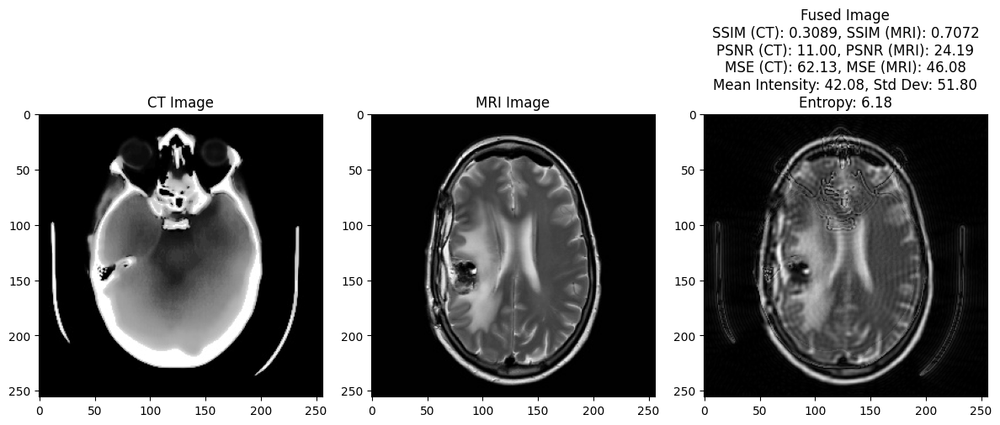

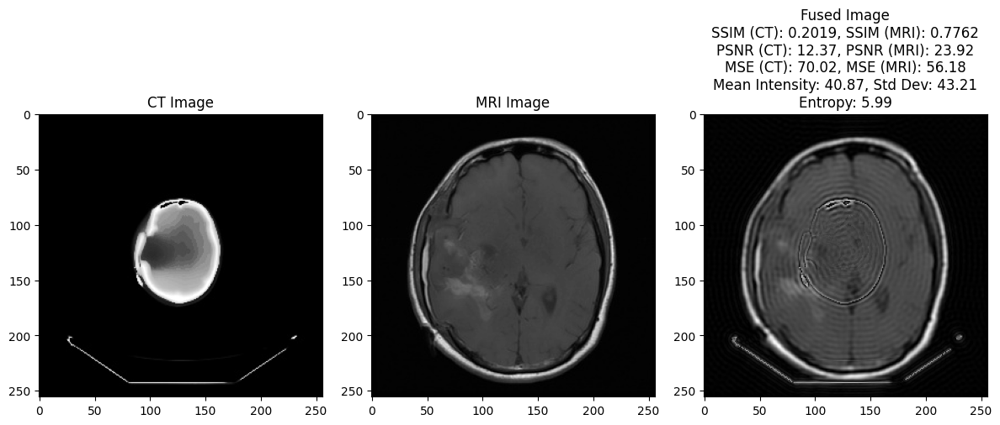

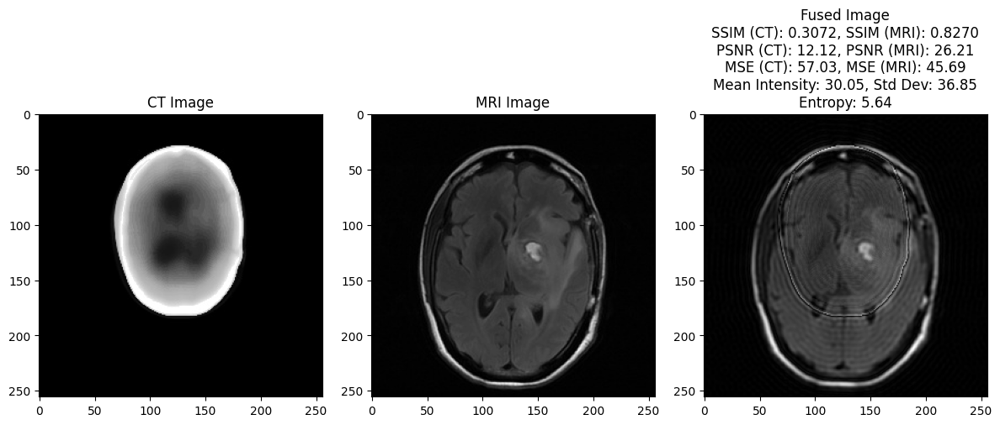

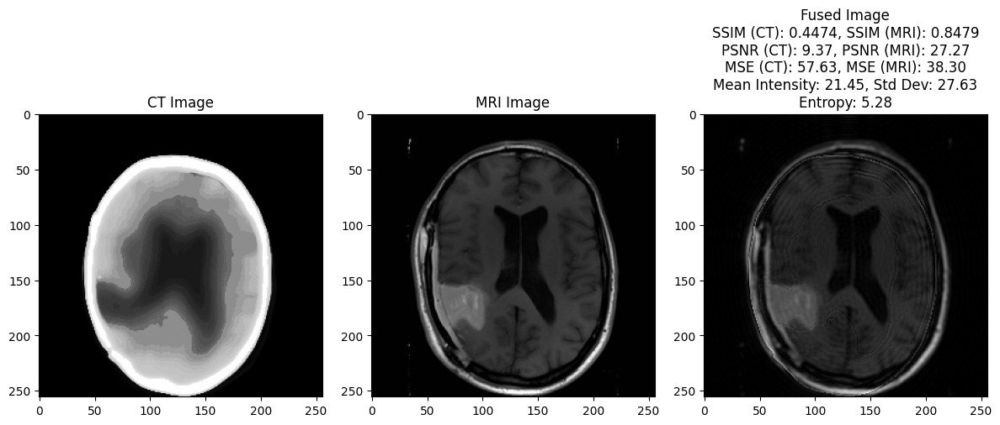

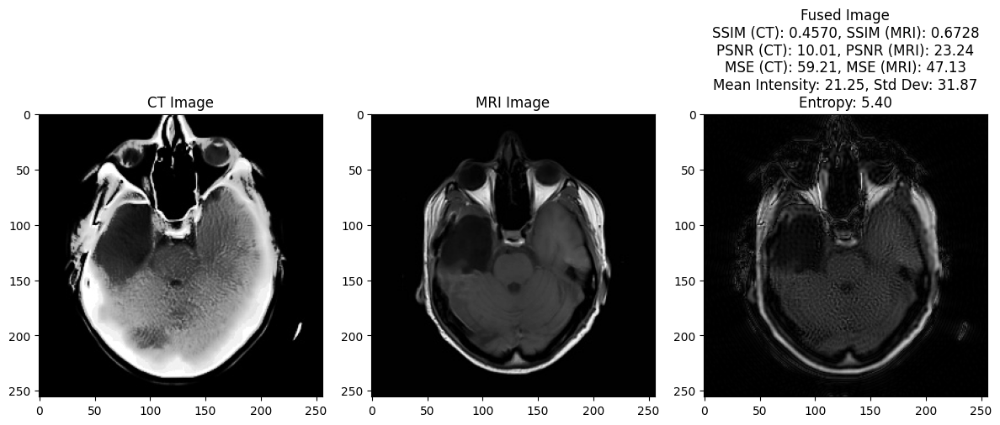

تم دمج الصور وحفظها في فولدر '/kaggle/working/fused'.


In [7]:
import os
import cv2
import numpy as np
from matplotlib import pyplot as plt
from skimage.metrics import structural_similarity as ssim
from skimage.measure import shannon_entropy

# المسارات الرئيسية
ct_folder = "/kaggle/working/ProcessedCT"
mri_folder = "/kaggle/working/ProcessedMRI"
output_folder = "/kaggle/working/fused"

# التأكد من وجود فولدر الناتج
os.makedirs(output_folder, exist_ok=True)

# قراءة الفولدرات الفرعية
ct_subfolders = sorted(os.listdir(ct_folder))
mri_subfolders = sorted(os.listdir(mri_folder))

# دمج الصور
for ct_subfolder, mri_subfolder in zip(ct_subfolders, mri_subfolders):
    ct_path = os.path.join(ct_folder, ct_subfolder)
    mri_path = os.path.join(mri_folder, mri_subfolder)

    # قراءة الصور داخل الفولدرات الفرعية
    ct_image_name = os.listdir(ct_path)[0]
    mri_image_name = os.listdir(mri_path)[0]

    ct_image = cv2.imread(os.path.join(ct_path, ct_image_name), cv2.IMREAD_GRAYSCALE)
    mri_image = cv2.imread(os.path.join(mri_path, mri_image_name), cv2.IMREAD_GRAYSCALE)

    # توحيد الأبعاد (استخدام أبعاد CT كمرجع)
    mri_image = cv2.resize(mri_image, (ct_image.shape[1], ct_image.shape[0]), interpolation=cv2.INTER_AREA)

    # Fourier Transform لكل صورة
    ct_fft = np.fft.fft2(ct_image)
    mri_fft = np.fft.fft2(mri_image)

    # إنشاء مرشح الترددات
    rows, cols = ct_image.shape
    crow, ccol = rows // 2, cols // 2

    # إنشاء ماسك للترددات المنخفضة
    mask_low = np.zeros((rows, cols), np.uint8)
    radius = 50 # نصف القطر للترددات المنخفضة
    cv2.circle(mask_low, (ccol, crow), radius, 1, thickness=-1)

    # الترددات العالية هي عكس الترددات المنخفضة
    mask_high = 1 - mask_low

    # تطبيق المرشحات
    ct_fft_low = np.fft.fftshift(ct_fft) * mask_low
    ct_fft_high = np.fft.fftshift(ct_fft) * mask_high
    mri_fft_low = np.fft.fftshift(mri_fft) * mask_low
    mri_fft_high = np.fft.fftshift(mri_fft) * mask_high

    # دمج الترددات
    fused_fft = ct_fft_high + mri_fft_low
    fused_fft = np.fft.ifftshift(fused_fft)

    # Inverse Fourier Transform
    fused_image = np.fft.ifft2(fused_fft)
    fused_image = np.abs(fused_image)
    fused_image = (fused_image / np.max(fused_image) * 255).astype(np.uint8)

    # تحسين التباين وتقليل الضوضاء
    # fused_image = cv2.equalizeHist(fused_image)
    # fused_image = cv2.GaussianBlur(fused_image, (5, 5), 0)

    # حساب القيم الإحصائية للصورة المدموجة
    mean_intensity = np.mean(fused_image)
    std_dev_intensity = np.std(fused_image)
    entropy = shannon_entropy(fused_image)

    # حساب SSIM و PSNR و MSE
    ssim_ct = ssim(fused_image, ct_image)
    ssim_mri = ssim(fused_image, mri_image)
    psnr_ct = cv2.PSNR(fused_image, ct_image)
    psnr_mri = cv2.PSNR(fused_image, mri_image)
    mse_ct = np.mean((fused_image - ct_image) ** 2)
    mse_mri = np.mean((fused_image - mri_image) ** 2)

    # حفظ الصورة الناتجة
    output_path = os.path.join(output_folder, f"{ct_subfolder}_fused.png")
    cv2.imwrite(output_path, fused_image)

    # عرض الصور والنتائج
    plt.figure(figsize=(12, 6))
    plt.subplot(1, 3, 1), plt.imshow(ct_image, cmap='gray'), plt.title("CT Image")
    plt.subplot(1, 3, 2), plt.imshow(mri_image, cmap='gray'), plt.title("MRI Image")
    plt.subplot(1, 3, 3), plt.imshow(fused_image, cmap='gray'), plt.title(
        f"Fused Image\nSSIM (CT): {ssim_ct:.4f}, SSIM (MRI): {ssim_mri:.4f}\n"
        f"PSNR (CT): {psnr_ct:.2f}, PSNR (MRI): {psnr_mri:.2f}\n"
        f"MSE (CT): {mse_ct:.2f}, MSE (MRI): {mse_mri:.2f}\n"
        f"Mean Intensity: {mean_intensity:.2f}, Std Dev: {std_dev_intensity:.2f}\n"
        f"Entropy: {entropy:.2f}"
    )
    plt.tight_layout()
    plt.show()

print(f"تم دمج الصور وحفظها في فولدر '{output_folder}'.")
